# Zad.1.
Zamień sygnał na sumę sygnałów <b>(1 pkt)</b> np
```julia
x = sin.(2*pi*t*200) + 2* sin.(2*pi*t*400) 
```

  Zaobserwuj wynik transformaty i wyjaśnij go.

In [1]:
using Plots
using FFTW

## Auxiliary functions

In [2]:
function plot_pressure(time_array, signal, title)
    return plot(time_array, signal, title=title, xlabel="Time [ms]", ylabel="Pressure", label="")
end

function plot_fourier_transform(signal_fft, title)
    return sticks(abs.(signal_fft), title=title, xlabel="Frequency [Hz]", ylabel="Power", label="")
end

function scale_wave_to_rms(signal, required_rms)    
    rms = sqrt(mean(signal.^2))
    scale_factor = required_rms / rms
    return signal * scale_factor
end;

In [3]:
# sampling frequency
Fs = 1024

# time points in interval [0, 1] every 1/Fs
t = 0:1/(Fs-1):1;

In [4]:
x = sin.(2*pi*t*200) + 2 * sin.(2*pi*t*400);

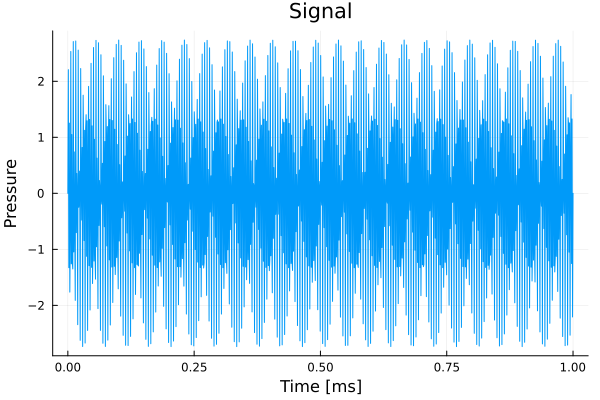

In [5]:
plot_pressure(t, x, "Signal")

In [6]:
y = fft(x);

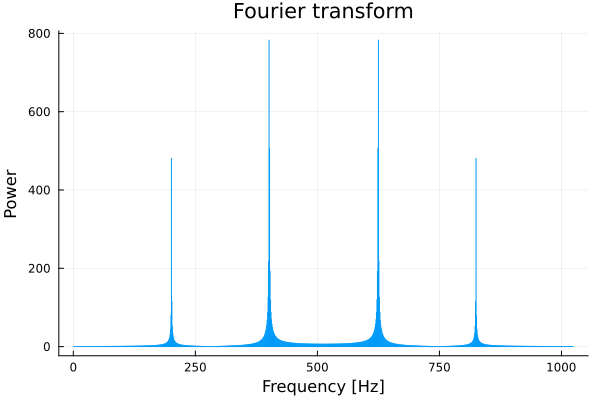

In [7]:
plot_fourier_transform(y, "Fourier transform")

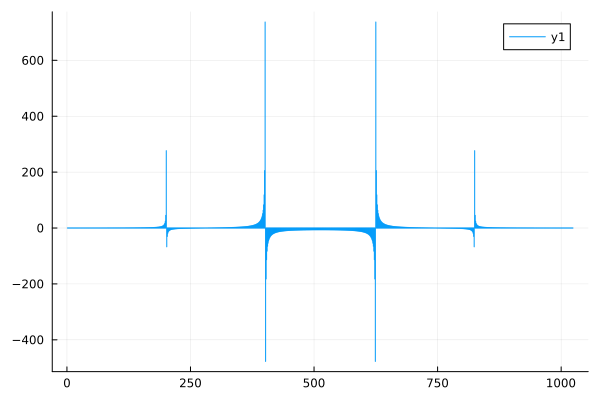

In [8]:
sticks(real(y))

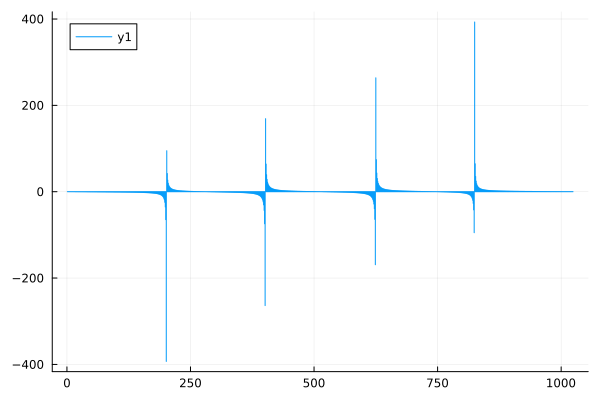

In [9]:
sticks(imag(y))

## Transormation interpretation

The real-input (r2c) DFT in FFTW computes the forward transform $Y$ of the size $n$ real array $X$, exactly as defined above, i.e.
$$Y_k=\sum_{j=0}^{n-1}X_je^{-2\pi ijk/n}$$
This output array $Y$ can easily be shown to possess the “Hermitian” symmetry $Y_k = Y_{n-k}^*$, where we take $Y$ to be periodic so that $Y_n = Y_0$.

As a result of this symmetry, half of the output $Y$ is redundant (being the complex conjugate of the other half), and so the 1d r2c transforms only output elements $0…\frac{n}{2}$ of $Y$ ($\frac{n}{2+1}$ complex numbers), where the division by 2 is rounded down.

This property arises because the complex exponential term $e^{-2\pi ijk/n}$ in the DFT equation has the property $e^{-2\pi ij(n-k)/n} = e^{-2\pi ijk/n}*$, which leads to the Hermitian symmetry.

# Zad.2.
Usuwanie szumów <b>(1 pkt)</b> :

    1. Wypełniamy tablicę wartościami funkcji cosinus ("sygnału") zaburzonej niewielkim "szumem" np. dodając do każdej wartości wylosowaną liczbę funkcją rand().
    2. Proszę narysować wykres zaszumionej funkcji.
    3. Narysować wykres transformaty Fouriera (widmo)  tego sygnału (jak poprzednio).
    4. Po transformacie wyzerowac w widmie wszystkie elementy, których wartość bezwzględna jest mniejsza niz 50. W ten sposób usuwamy "szumy" z sygnału.
    5.Przeprowadzić odwrotną transformatę funkcją ifft(). Narysować wykres otrzymanej funkcji dla <b>częsci  rzeczywistej</b>. Porównać z wejściowym wykresem sygnału.

In [10]:
# sampling frequency
Fs = 1024

# time points in interval [0, 1] every 1/Fs
t = 0:1/(Fs-1):1;

In [11]:
x = cos.(2*pi*t*200)+rand(Float64, length(t));

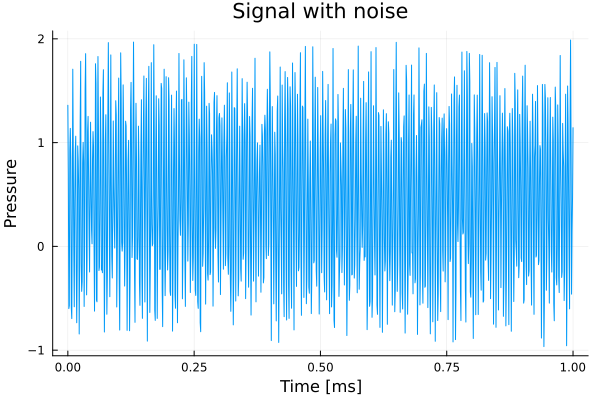

In [12]:
plot_pressure(t, x, "Signal with noise")

In [13]:
y = fft(x);

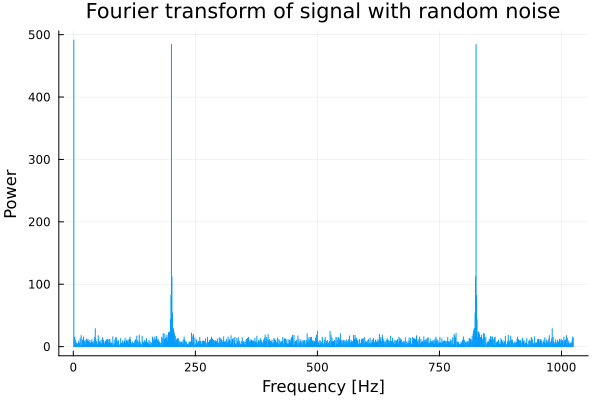

In [14]:
plot_fourier_transform(y, "Fourier transform of signal with random noise")

In [15]:
corrected_y = [abs(z) < 50 ? 0.0+0.0im : z for z in y];
typeof(corrected_y)

Vector{ComplexF64} (alias for Array{Complex{Float64}, 1})

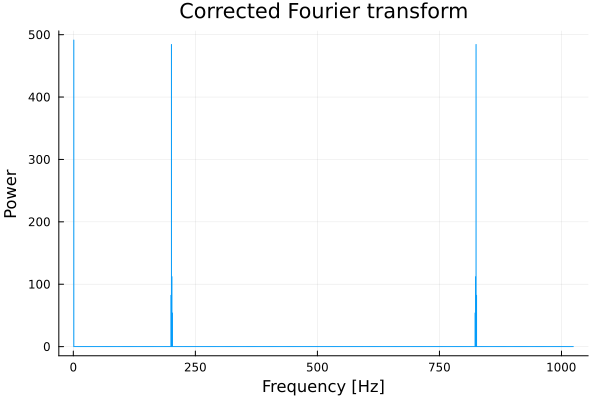

In [16]:
plot_fourier_transform(corrected_y, "Corrected Fourier transform")

In [17]:
corrected_x = ifft(corrected_y);

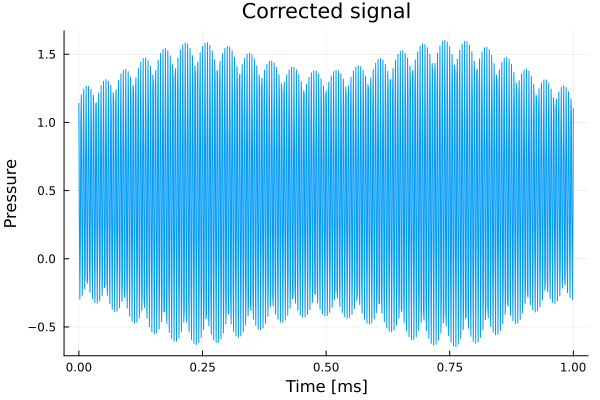

In [18]:
plot_pressure(t, real(corrected_x), "Corrected signal")

W poprawionym sygnale wyraźnie widać początkową funkcje cosinus, szczególnie w środkowym przedziale.

# Zad.3.
Proszę nagrać własny glos i zastosować na nim trasformatę Fouriera, narysować wykres widma. Następnie poeksperymentować (wyciąć wybrane częstotliwości), dokonać odwrotnej transformaty i odsłuchać efekt <b>(3 pkt)</b> .
<p>
Przydatne materiały:
     1. <a href="http://samcarcagno.altervista.org/blog/basic-sound-processing-julia/"> Basic sound processing</a>
     2. <a href="https://github.com/dancasimiro/WAV.jl"> Pakiet Wav </a>

In [19]:
using Pkg
#Pkg.add("WAV")

using WAV
using Plots
using Statistics

In [20]:
# Used for making some sound louder

# sound, sampling_frequency = wavread("my_voice.wav");
# size(sound)
# sound *= 8
# wavwrite(sound, "my_voice.wav", Fs=sampling_frequency)
# wavplay("my_voice.wav")

In [21]:
# loading requested sound
sound, sampling_frequency = wavread("my_voice.wav");
n, _ = size(sound)

(13312, 2)

In [22]:
# we'll work only with chanel 1 from now onwards
s1 = sound[:,1];
wavwrite(s1, "Original.wav", Fs=sampling_frequency)
wavplay("Original.wav")

In [23]:
# Time of recording [s]
sound_time = size(s1, 1) / sampling_frequency

0.6037188f0

In [24]:
# time array
time_array = (0:(size(s1, 1)-1)) / sampling_frequency
time_array *= 1000  # scaling to miliseconds

0.0f0:0.04535147f0:603.67346f0

## Original sound

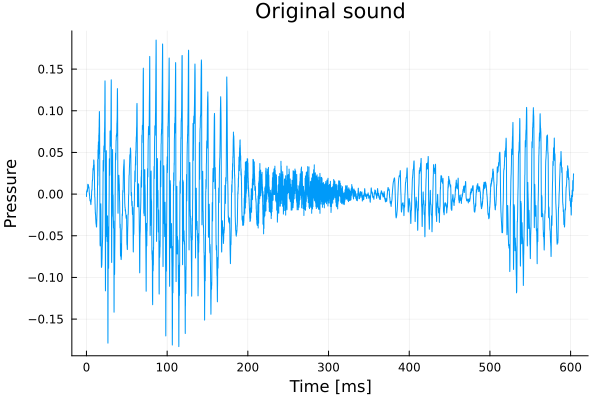

In [25]:
plot_pressure(time_array, s1, "Original sound")

In [26]:
# Root mean square - measure of waveform amplitude
rms_val = sqrt(mean(s1.^2))

0.04147038109257873

In [27]:
s1_fft = fft(s1);
plot_fourier_transform(s1_fft, "Original sound")

## Low frequencies removed

In [1]:
title = "Low frequencies removed";

In [29]:
f_bound = 2000
s1_fft_modified = copy(s1_fft)
s1_fft_modified[1:f_bound] = zeros(ComplexF64, f_bound);
s1_fft_modified[n-f_bound+1:n] = zeros(ComplexF64, f_bound);

In [30]:
plot_fourier_transform(s1_fft_modified, title)

In [31]:
s1_modified = real(ifft(s1_fft_modified))

# Scale the modified waveform back to original power
s1_modified = scale_wave_to_rms(s1_modified, rms_val);

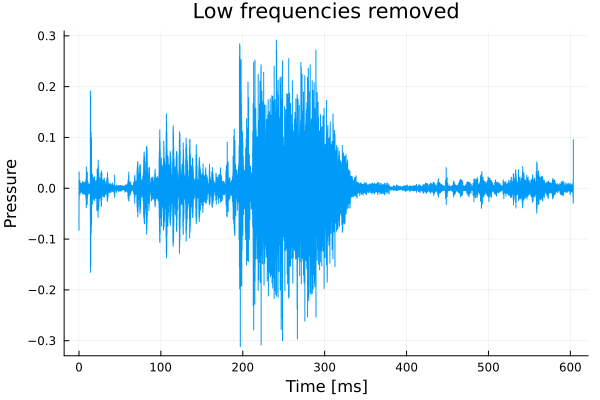

In [32]:
plot_pressure(time_array, s1_modified, title)

In [33]:
wavwrite(s1_modified, title*".wav", Fs=sampling_frequency)
wavplay("Original.wav")
wavplay(title*".wav")

## High frequencies removed

In [68]:
title="High frequencies removed";

In [69]:
f_bound = 1000
s1_fft_modified = copy(s1_fft)
s1_fft_modified[f_bound:n-f_bound-1] = zeros(ComplexF64, n-2*f_bound);

In [36]:
plot_fourier_transform(s1_fft_modified, title)

In [70]:
s1_modified = real(ifft(s1_fft_modified))

# Scale the modified waveform back to original power
s1_modified = scale_wave_to_rms(s1_modified, rms_val);

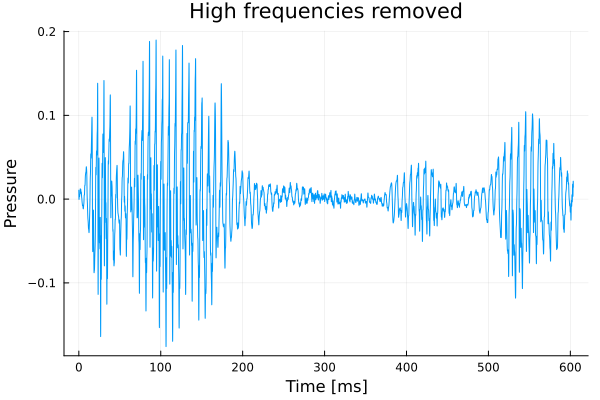

In [38]:
plot_pressure(time_array, s1_modified, title)

In [71]:
wavwrite(s1_modified, title*".wav", Fs=sampling_frequency)
wavplay("Original.wav")
wavplay(title*".wav")

## Low power frequencies removed

In [40]:
title="Low power frequencies removed";

In [41]:
f_bound = 5
s1_fft_modified = copy(s1_fft)
s1_fft_modified = [abs(z) < f_bound ? 0.0+0.0im : z for z in s1_fft_modified];

In [42]:
plot_fourier_transform(s1_fft_modified, title)

In [43]:
s1_modified = real(ifft(s1_fft_modified))

# Scale the modified waveform back to original power
s1_modified = scale_wave_to_rms(s1_modified, rms_val);

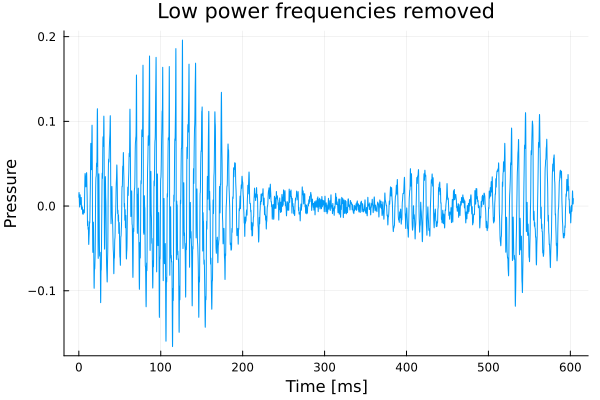

In [44]:
plot_pressure(time_array, s1_modified, title)

In [45]:
wavwrite(s1_modified, title*".wav", Fs=sampling_frequency)
wavplay("Original.wav")
wavplay(title*".wav")

## High power frequencies removed

In [46]:
title="High power frequencies removed";

In [47]:
f_bound = 15
s1_fft_modified = copy(s1_fft)
s1_fft_modified = [abs(z) > f_bound ? 0.0+0.0im : z for z in s1_fft_modified];

In [48]:
plot_fourier_transform(s1_fft_modified, title)

In [49]:
s1_modified = real(ifft(s1_fft_modified))

# Scale the modified waveform back to original power
s1_modified = scale_wave_to_rms(s1_modified, rms_val);

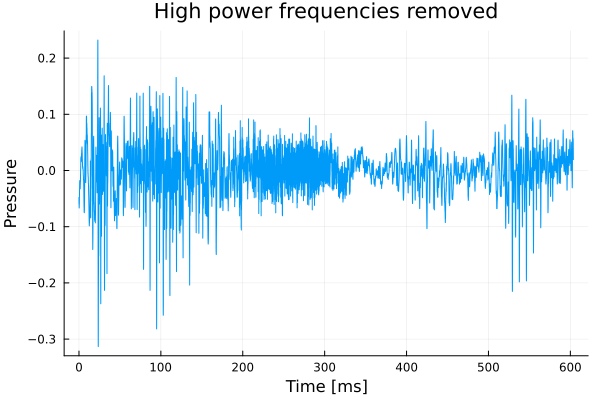

In [50]:
plot_pressure(time_array, s1_modified, title)

In [51]:
wavwrite(s1_modified, title*".wav", Fs=sampling_frequency)
wavplay("Original.wav")
wavplay(title*".wav")

## Stronger low frequencies

In [52]:
title="Stronger low frequencies";
addend = 1
multiplier = 50
n

13312

We will smoothly, in linear manner, multiply low frequencies from 1 up to f_bound

In [53]:
scale_function = x -> (abs(x/n - 1/2)) * multiplier + addend
aux = [i for i in 1:n];

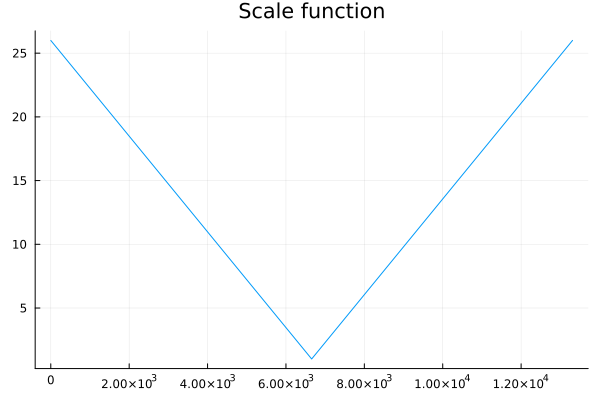

In [54]:
plot(aux, scale_function.(aux), title="Scale function", label="")

In [55]:
s1_fft_modified = copy(s1_fft)
s1_fft_modified = [z*scale_function(i) for (i, z) in enumerate(s1_fft_modified)];

In [56]:
plot_fourier_transform(s1_fft_modified, title)

In [57]:
s1_modified = real(ifft(s1_fft_modified))

# Scale the modified waveform back to original power
s1_modified = scale_wave_to_rms(s1_modified, rms_val);

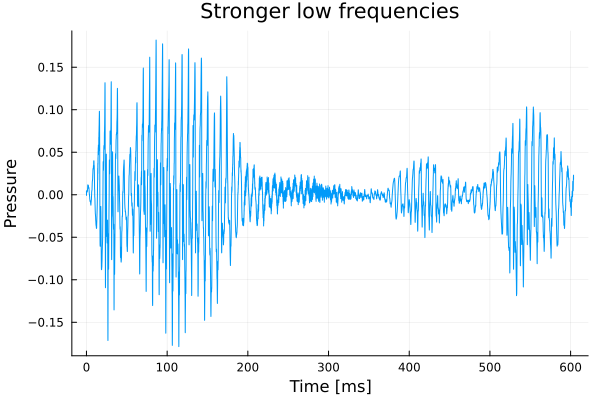

In [58]:
plot_pressure(time_array, s1_modified, title)

In [59]:
wavwrite(s1_modified, title*".wav", Fs=sampling_frequency)
wavplay("Original.wav")
wavplay(title*".wav")

## Stronger high frequencies

In [60]:
title="Stronger high frequencies";
addend = 0.5
multiplier = 100
n

13312

In [61]:
scale_function = x -> (-(abs(x/n - 1/2)) + 1/2) * multiplier + addend
aux = [i for i in 1:n];

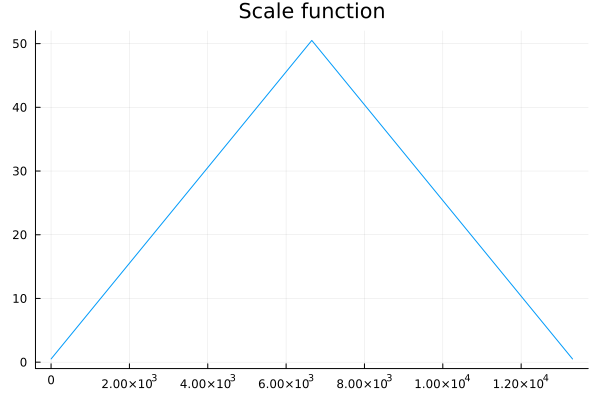

In [62]:
plot(aux, scale_function.(aux), title="Scale function", label="")

In [63]:
s1_fft_modified = copy(s1_fft)
s1_fft_modified = [z*scale_function(i) for (i, z) in enumerate(s1_fft_modified)];

In [64]:
plot_fourier_transform(s1_fft_modified, title)

In [65]:
s1_modified = real(ifft(s1_fft_modified))

# Scale the modified waveform back to original power
s1_modified = scale_wave_to_rms(s1_modified, rms_val);

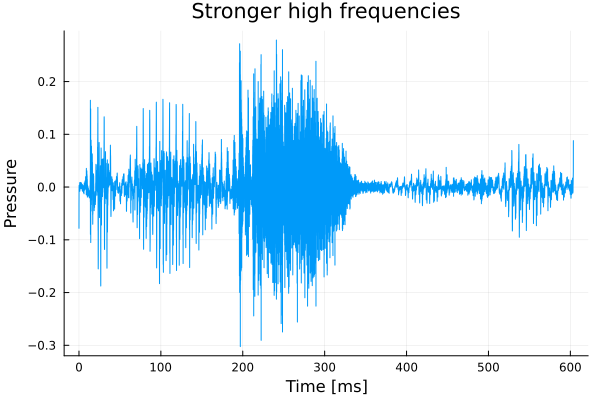

In [66]:
plot_pressure(time_array, s1_modified, title)

In [67]:
wavwrite(s1_modified, title*".wav", Fs=sampling_frequency)
wavplay("Original.wav")
wavplay(title*".wav")